## Chapter 3: Derivatives and Automatic Differentiation

# 3.7 Derivatives of multi-input functions

In this Section we describe how derivatives are defined in higher dimensions, when dealing with multi-input functions.  We explore these ideas first with $N=2$ inputs for visualization purposes, generalizing afterwards. 

Press the botton 'Toggle code' below to toggle code on and off for entire this Section.

In [4]:
# toggle code on and off for entire Section
%run -i 'toggle_code.py' 

Toggle code

In [1]:
# This code cell will not be shown in the HTML version of this notebook
# imports from custom library
import sys
sys.path.append('../../')
import matplotlib.pyplot as plt
from mlrefined_libraries import basics_library as baslib
from mlrefined_libraries import calculus_library as callib
import autograd.numpy as np

# this is needed to compensate for matplotlib notebook's tendancy to blow up images when plotted inline
%matplotlib notebook
from matplotlib import rcParams
rcParams['figure.autolayout'] = True

## 3.7.1 From tangent line to tangent hyperplane

Instead of the derivative representing the slope of a tangent line in the case of a single-input function, the derivative of a multi-input function represents the set of slopes that define a *tangent hyperplane*.  

#### <span style="color:#a50e3e;">Example 1. </span>  Tangent hyperplane


This is illustrated in the next Python cell using the following two closely related functions

\begin{array}
\
g(w) = 2 + \text{sin}(w)\\
g(w_1,w_2) = 2 + \text{sin}(w_1 + w_2) 
\end{array}

In particular we draw each function over a small portion of its input around the origin, with the single-input function on the left and multi-input function on the right.  We also draw the tangent line / hyperplane - generated by the derivative there - on top of each function at the origin.  

<IPython.core.display.Javascript object>


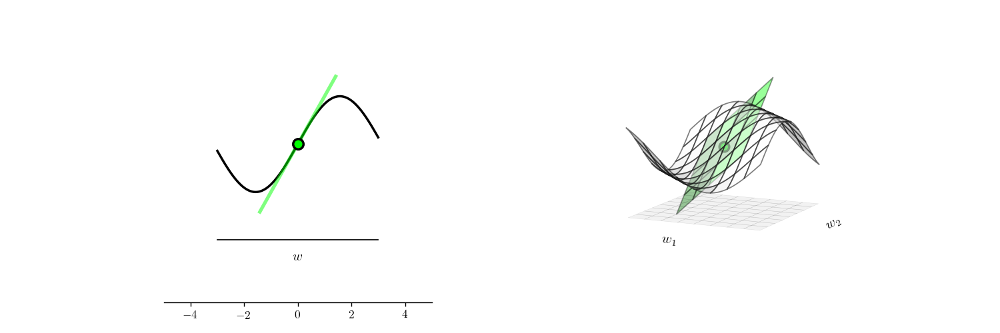

In [2]:
# plot a single input quadratic in both two and three dimensions
func1 = lambda w: 2 + np.sin(w) 
func2 = lambda w: 2 + np.sin(w[0] + w[1]) 

# use custom plotter to show both functions
callib.derivative_ascent_visualizer.compare_2d3d(func1 = func1,func2 = func2)

Here we can see that the derivative for the multi-input function on the right naturally describes not just a line, but a tangent hyperplane.  This is true in general.  How do we define the derivative of a multi-input function / the tangent hyperplane it generates?

## 3.7.2  Derivatives: from secants to tangents 

In Section 3.2 we saw how the derivative of a single input function $g(w)$ at a point $w^0$ was approximately the slope 

\begin{equation}
 \frac{\mathrm{d}}{\mathrm{d}w}g(w^0) \approx \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} 
\end{equation}

of the secant line passing through the point $(w^0,\,\,g(w^0))$ and a neighboring point $(w^0 + \epsilon, \,\, g(w^0 + \epsilon))$, and letting $|\epsilon|$ shrink to zero this approximation becomes an equality, and the derivative is precisely the slope of the tangent line at $w^0$.

#### <span style="color:#a50e3e;">Example 2. </span>  Single input secant experiment

In the next Python cell we repeat an experiment illustrating this point from an earlier Section.  Here we plot the function $g(w) = \text{sin}(w)$ over a short window of its input. We then fix $w^0 = 0$, take a point nearby that can be controlled via the slider mechanism, and connect the two via a secant line.  When the neighborhood point is close enough to $0$ the secant line becomes tangent, and turns from red to green.


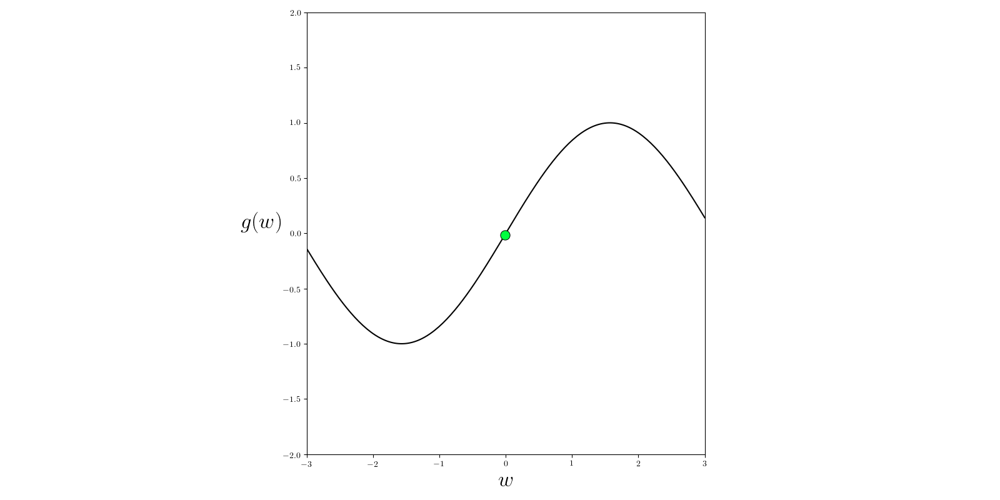
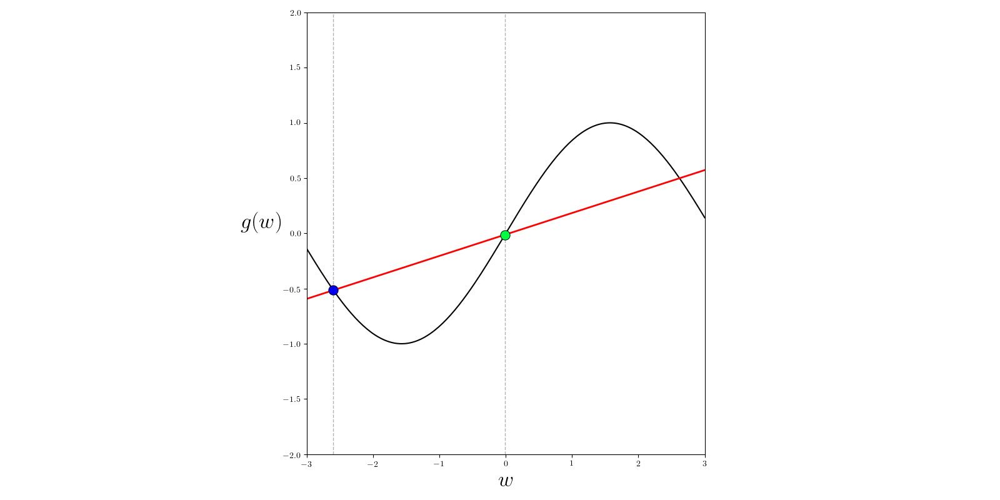
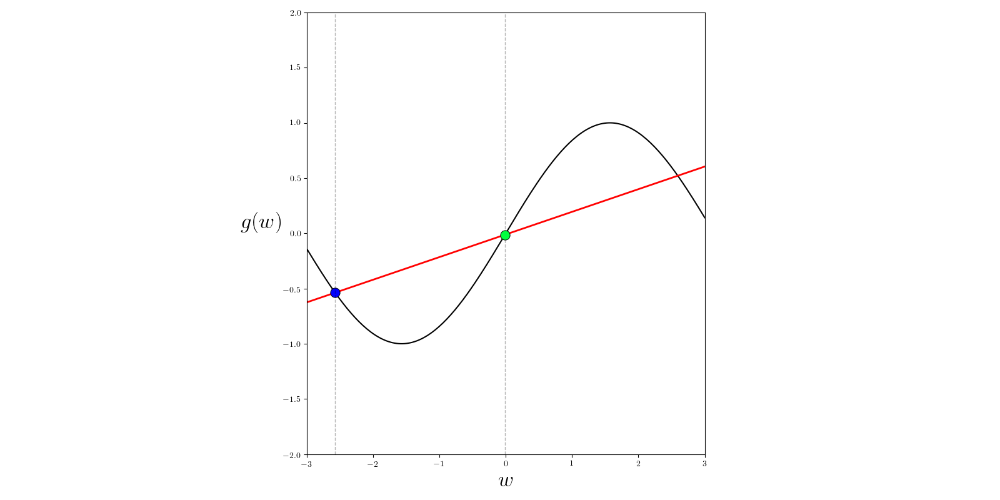
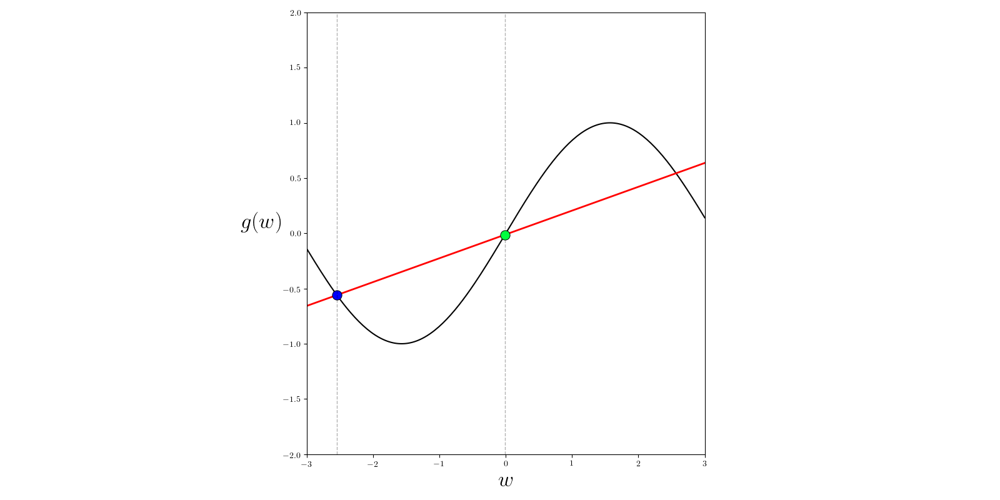
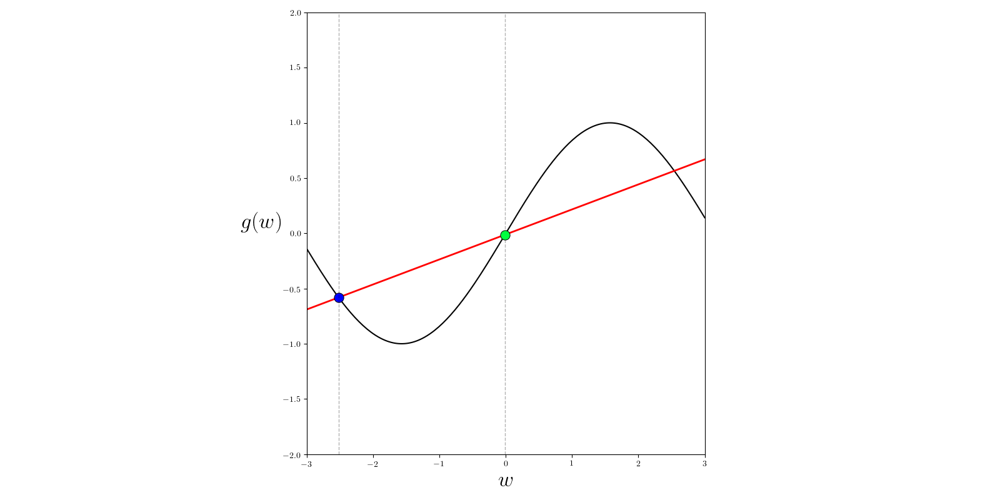
...
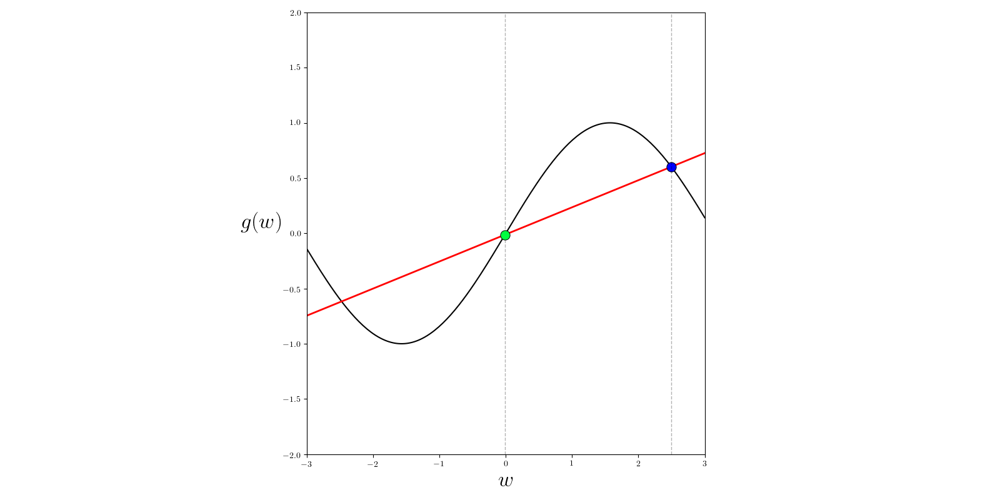
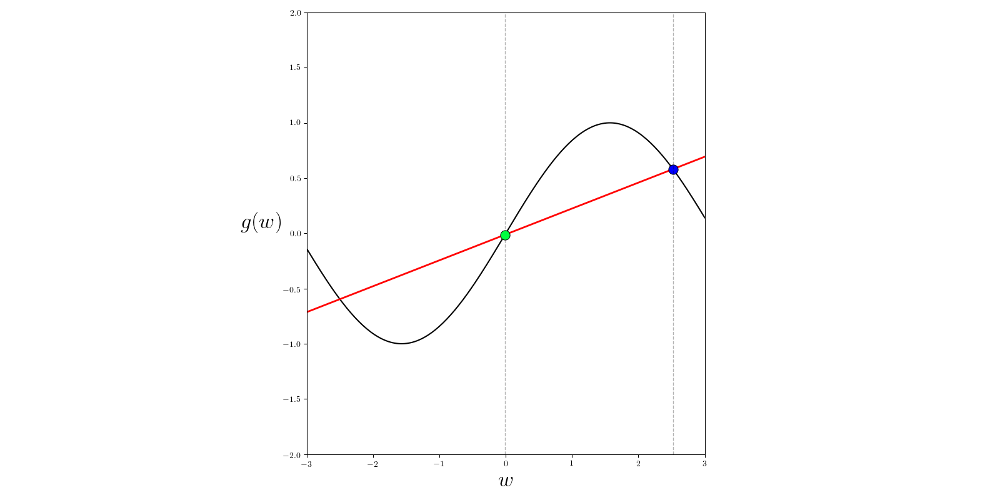
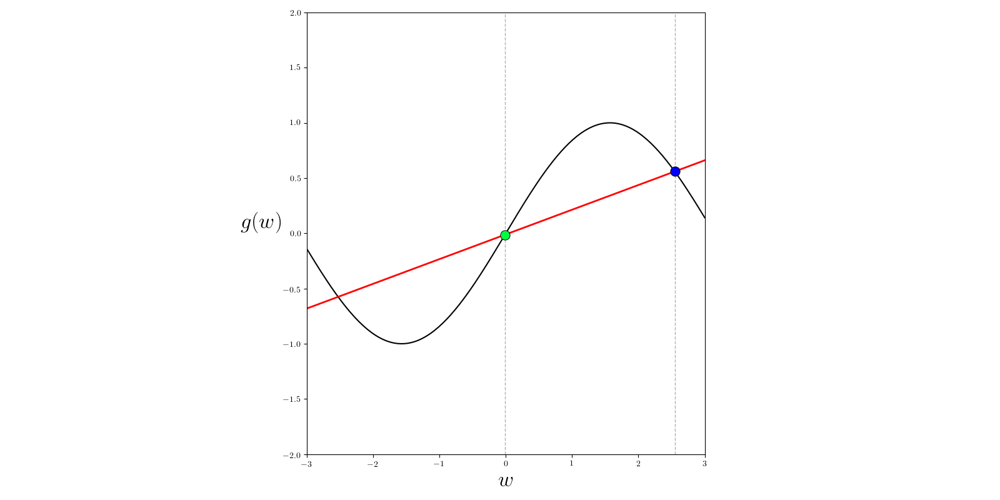
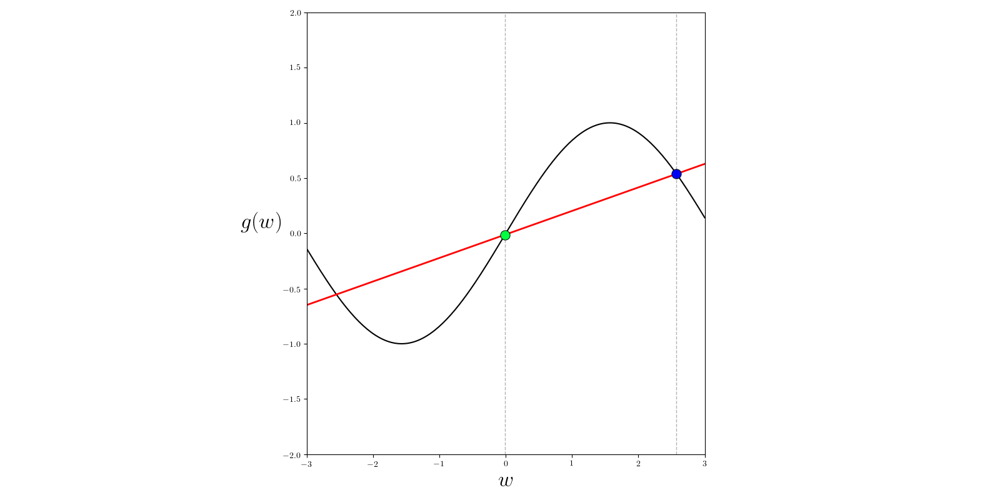
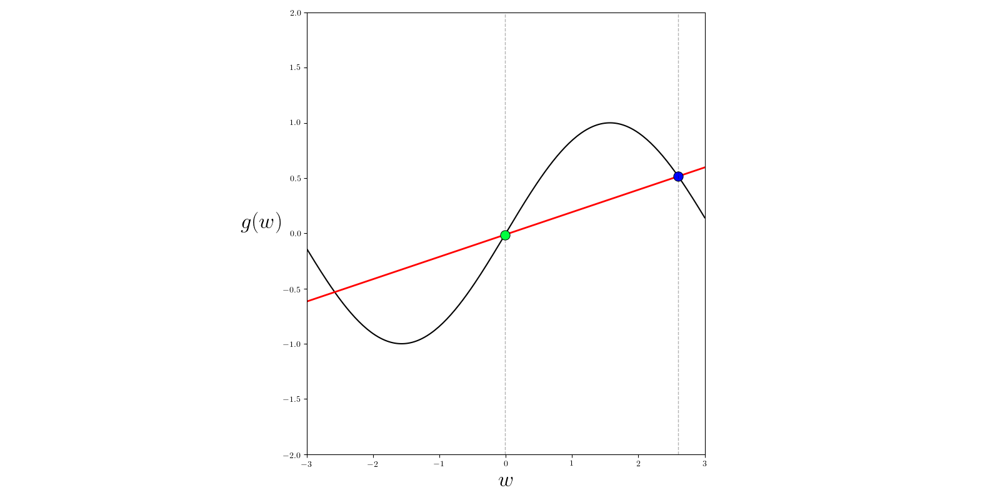

In [3]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.sin(w)

# create an instance of the visualizer with this function
st = callib.secant_to_tangent.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(w_init = 0, num_frames = 200)

---

With $N$ inputs we have precisely the same situation - only we can compute a derivative along each input axis, and all such derivatives at every point of the input space.  

For example, if we fix a point $(w_1,w_2) = (w^0_1,w^0_2)$ then we can examine the derivative along the first input axis $w_1$ using the same one-dimensional secant slope formula

\begin{equation}
 \frac{\mathrm{d}}{\mathrm{d}w_1}g(w^0_1,w^0_2) \approx \frac{g(w^0_1 + \epsilon,w^0_2) - g(w^0_1,w^0_2)}{\epsilon} 
\end{equation}

and again as $|\epsilon|$ shrinks to zero this approximation becomes an equality.  Since we are in two dimensions the secant line with this slope is actually a hyperplane passing through the points $(w^0_1,w^0_2,g(w^0_1,w^0_2))$ and $(w^0_1 + \epsilon,w^0_2,g(w^0_1 + \epsilon,w^0_2))$.  Likewise to compute the derivative in the second input axis $w_2$ here we compute the slope value

\begin{equation}
 \frac{\mathrm{d}}{\mathrm{d}w_2}g(w^0_1,w^0_2) \approx \frac{g(w^0_1 ,w^0_2 + \epsilon) - g(w^0_1,w^0_2)}{\epsilon} 
\end{equation}

Because each of the derivatives $\frac{\mathrm{d}}{\mathrm{d}w_1}g(w^0_1,w^0_2)$ and $\frac{\mathrm{d}}{\mathrm{d}w_2}g(w^0_1,w^0_2)$ is taken with respect to a single input, they are referred to as *partial derivatives* of the function $g(w_1,w_2)$. 

Moreover, more commonly one uses a different notation to distinguish them from single input derivatives - replacing the $\mathrm{d}$ symbol with $\partial$.  With this notation derivatives above are written equivalently as  $\frac{\partial}{\partial w_1}g(w^0_1,w^0_2)$ and $\frac{\partial}{\partial w_2}g(w^0_1,w^0_2)$.  Regardless of the notation partial derivatives are computed - as we will discuss in the next Sectionst - in virtually the same manner as single-input derivatives are (i.e., via repeated use of the derivative rules for elementary functions and operations).


This nomenclature and notation is used more generally as well to refer to any derivative of a multi-input function with respect to a single input dimension.

> The term *partial derivative* is used to describe any derivative of a multi-input function with respect to a single input dimension.

#### <span style="color:#a50e3e;">Example 3. </span> Multi-input secant experiment

In the next Python cell we repeat the secant experiment - shown previously for a single-input function - for the following multi-input function

\begin{equation}
g(w_1,w_2) = 5 + (w_1 + 0.5)^2 + (w_2 + 0.5)^2
\end{equation}

We fix the point $(w^0_1,w^0_2) = (0,0)$ and take a point along each axis whose proximity to the origin can be controlled via the slider mechanism.  At each instance and in each input dimension we form a secant line (which is a hyperplane in three dimensions) connecting the evaluation of this point to that of the origin.  The secant hyperplane whose slope is given by the partial derivative approximation $\frac{\partial}{\partial w_1}g(w^0_1,w^0_2)$ and $\frac{\partial}{\partial w_2}g(w^0_1,w^0_2)$ are then illustrated in the left and right panels of the output, respectively.

When the neighborhood point is close enough to the origin the secant becomes tangent in each input dimension, and the corresponding hyperplane changes color from red to green.


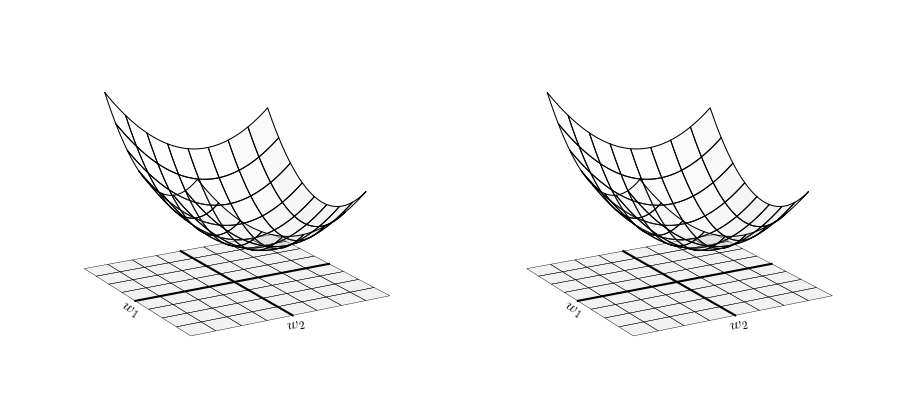
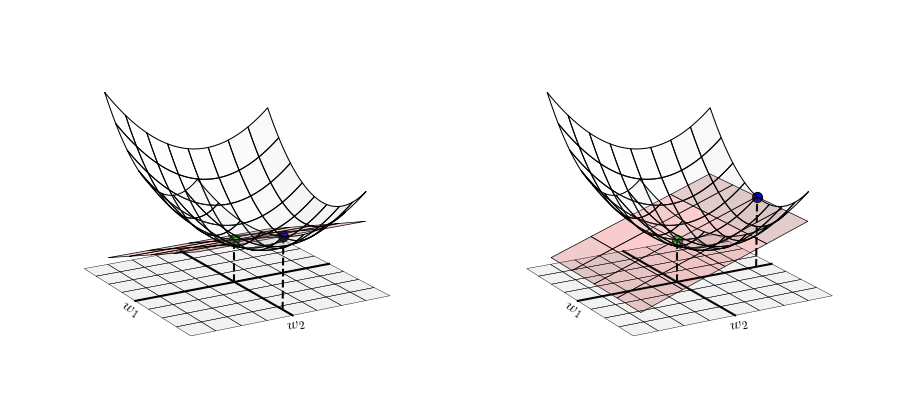
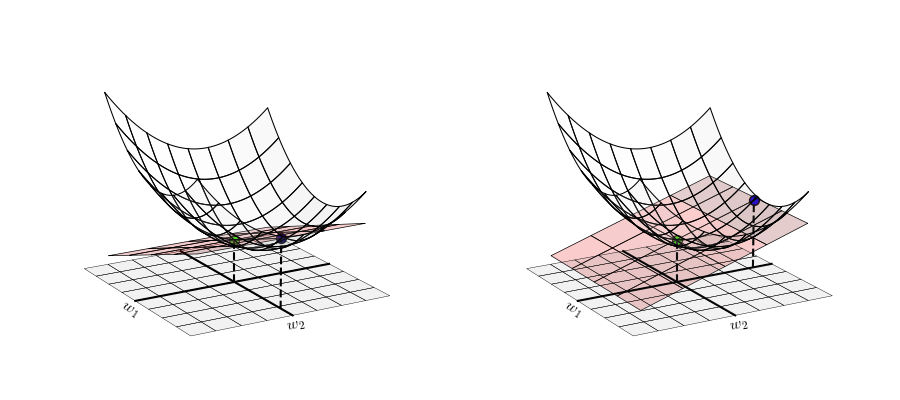
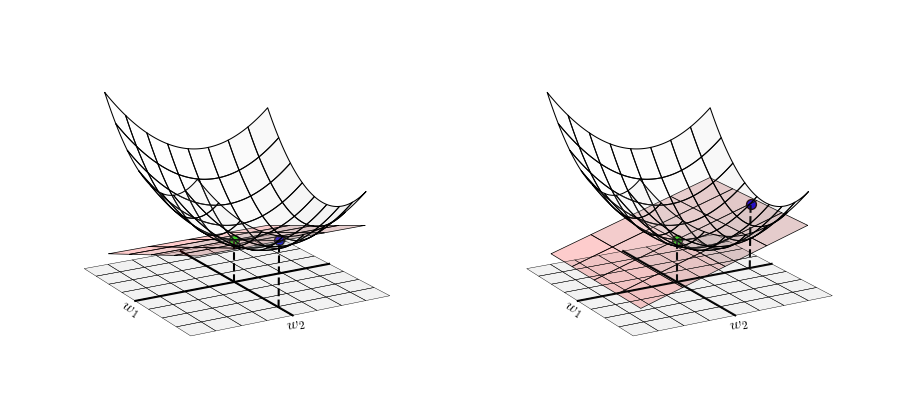
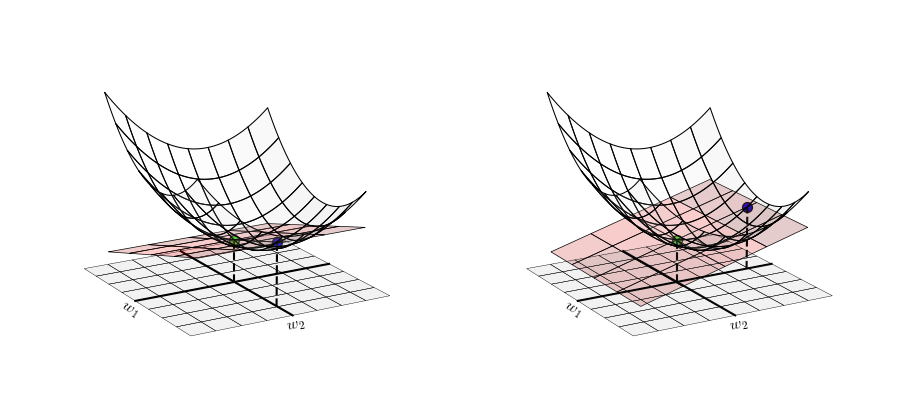
...
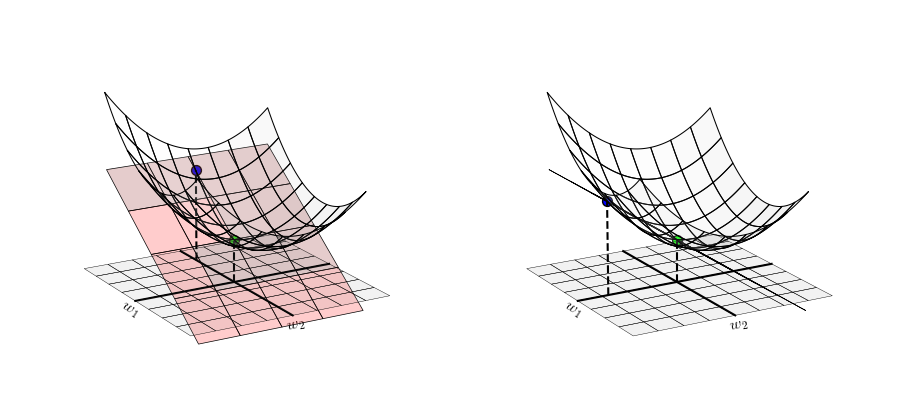
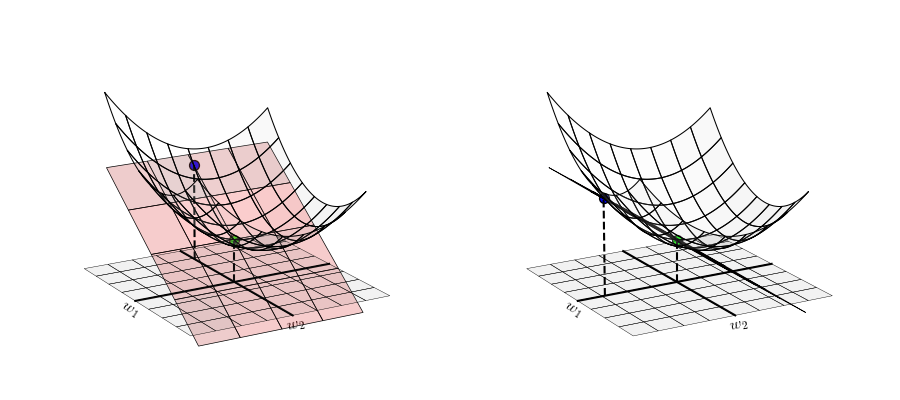
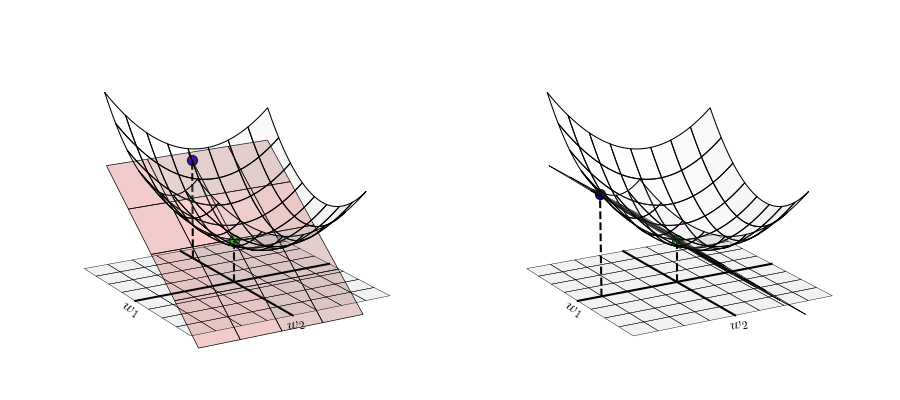
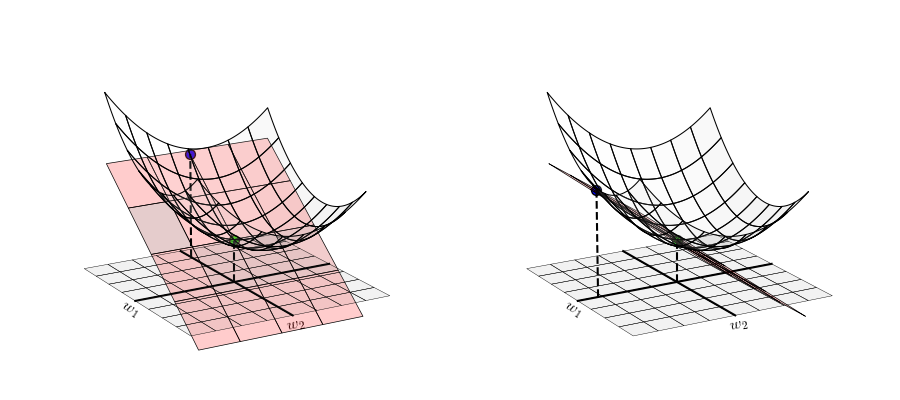
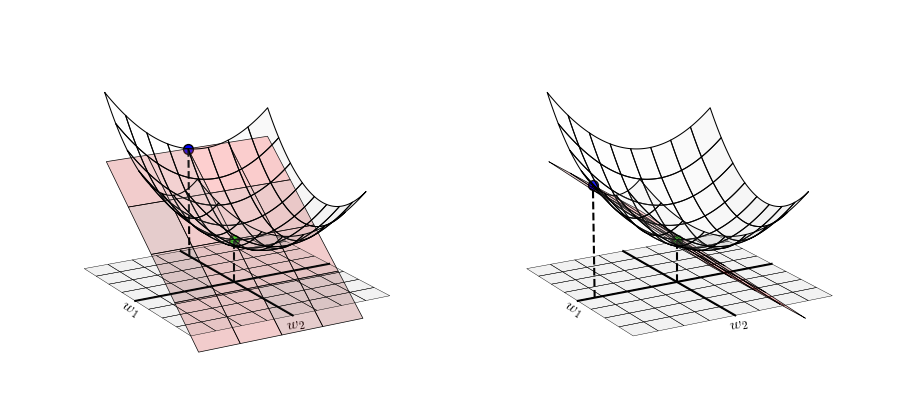

In [3]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
func = lambda w: 5 + (w[0] +0.5)**2 + (w[1]+0.5)**2 
view = [20,150]

# run the visualizer for our chosen input function and initial point
callib.secant_to_tangent_3d.animate_it(func = func,num_frames=50,view = view)

---

The hyperplanes at a point $(w^0_1,w^0_2)$ are tangent along each input dimension only - like those shown in the figure above - have a slope defined by the corresponding partial derivative.  Each such hyperplane is rather simple, in the sense that it has non-trivial slope in only a single input axis (we discussed this more generally in the previous Section), and have a single-input form of equation.  For example, the tangent hyperplane along the $w_1$ axis has the equation

\begin{equation}
h(w_1,w_2) = g(w^0_1,w^0_2) + \frac{\partial}{\partial w_1}g(w^0_1,w^0_2)(w^{\,}_1 - w^0_1)
\end{equation}

and likewise for the tangency along the $w_2$ axis. 

\begin{equation}
h(w_1,w_2) = g(w^0_1,w^0_2) + \frac{\partial}{\partial w_2}g(w^0_1,w^0_2)(w^{\,}_2 - w^0_2)
\end{equation}

However neither simple hyperplane represents the full tangency at the point  $(w^0_1,w^0_2)$, which must be a function of *both* inputs $w_1$ and $w_2$.  To get this we must sum up the slope contributions from both input axes, which gives the full tangent hyperplane

\begin{equation}
h(w_1,w_2) = g(w^0_1,w^0_2) + \frac{\partial}{\partial w_1}g(w^0_1,w^0_2)(w^{\,}_1 - w^0_1) +  \frac{\partial }{\partial w_2}g(w^0_1,w^0_2)(w^{\,}_2 - w^0_2)
\end{equation}

As was the case with the tangent line of a single-input function, this is also the *first order Taylor Series approximation* to $g$ at the point $(w^0_1,w^0_2)$.

#### <span style="color:#a50e3e;">Example 4. </span>  Arbitrary tangent hyperplane

In the next Python cell we illustrate each single-input tangency (with respect to $w_1$ and $w_2$ in the left and middle panels respectively), along with the full first order Taylor series approximation with the full tangent hyperplane (right panel) for the example function show in the previous animation.  

<IPython.core.display.Javascript object>


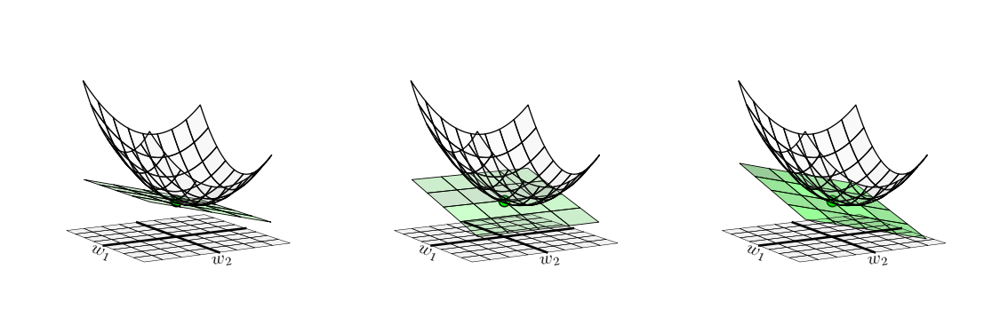

In [4]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
func = lambda w: 5 + (w[0] +0.5)**2 + (w[1]+0.5)**2
view = [10,150]

# run the visualizer for our chosen input function and initial point
callib.secant_to_tangent_3d.draw_it(func = func,num_frames=50,view = view)

---

So, in short, multi-input functions with $N=2$ inputs have $N=2$ partial derivatives, one for each input.  At a single point taken together these partial derivatives - like the sole derivative of a single-input function - define the slopes of the tangent hyperplane at this point (also called the first order Taylor Series approximation). 

## 3.7.3 The gradient

For notational convenience these partial derivatives are typically collected into a vector-valued function called the *gradient* denoted  $\nabla g(w_1,w_2)$, where the partial derivatives column-wise as

\begin{equation}
\nabla g(w_1,w_2) = 
\begin{bmatrix}
\
\frac{\partial}{\partial w_1}g(w_1,w_2) \\
\frac{\partial}{\partial w_2}g(w_1,w_2)
\end{bmatrix}
\end{equation}

Note because this is a stack of two derivatives the gradient in this case has two inputs *and* two outputs.  When a function has only a single input the gradient reduces to a single derivative, which is why the derivative of a function (regardless of its number of inputs) is typically just referred to as its gradient.

When a function takes in general $N$ number of inputs the form of the gradient, as well as the tangent hyperplane, mirror precisely what we have seen above.  A function taking in $N$ inputs $g(w_1,w_2,...,w_N)$ has a gradient consisting of its $N$ partial derivatives stacked into a column vector

\begin{equation}
\nabla g(w_1,w_2,..,w_N) = 
\begin{bmatrix}
\
\frac{\partial}{\partial w_1}g(w_1,w_2,..,w_N) \\
\frac{\partial}{\partial w_2}g(w_1,w_2,..,w_N) \\
\vdots \\
\frac{\partial}{\partial w_N}g(w_1,w_2,..,w_N) 
\end{bmatrix}
\end{equation}

To see why this is a convenient way to express the partial derivatives of $g$ note that using vector notation for the input, e.g., $\mathbf{w} = (w_1,w_2)$ and $\mathbf{w}^0 = (w^0_1,w^0_2)$ the first order Taylor Series approximation can be written more compactly as

\begin{equation}
h(\mathbf{w}) = g(\mathbf{w}^0) + \nabla g(\mathbf{w}^0)^T(\mathbf{w} - \mathbf{w}^0)
\end{equation}

which more closely resembles the way we express the first order Taylor Series approximation for a single-input function, regardless of the value of $N$.

## 3.7.4  Derivatives and the direction of greatest ascent

In the previous Section on general hyperplanes we described how - with a single-input function - the slope of a line describes its *direction of steepest (or greatest) ascent* and (its negative) the *direction of steepest descent*.  These are the directions one must travel (in the input space) to increase / decrease the value of the line as quickly as possible.  In this Subsection we look at the consequences of this fact for the particular case of a tangent line / hyperplane. 

### The steepest ascent direction of a tangent line

Since the derivative of a single-input function defines a tangent line at each in its input domain it also defines a direction ascent and descent at each input value.  Moreover because the tangent line is built to closely *approximate* its underlying function the ascent direction of a tangent line tells us not just the direction we should travel in in order to increase / decrease its value locally, but the direction we should travel in (at least locally around the input point defining the tangent line) in order to increase / decrease the value of the underlying function itself.  This is true more generally as well.

> The ascent / descent direction of a tangent hyperplane tells us the direction we must travel in (at least locally around where it most closely resembles its underlying function) in order to increase / decrease the value of the underlying function. 

#### <span style="color:#a50e3e;">Example 5. </span>  The derivative as a direction 

In the next Python cell we visualize the ascent and descent directions, derived from the tangent line, over a fine set of points for the single-input quadratic $g(w) =  1.5 + 0.4w^2$.  The derivative / ascent direction is plotted as a vector in black along the horizontal axis, while the negative derivative / descent direction is similarly shown in red.  The slider mechanism allows you to adjust the point along the input axis.


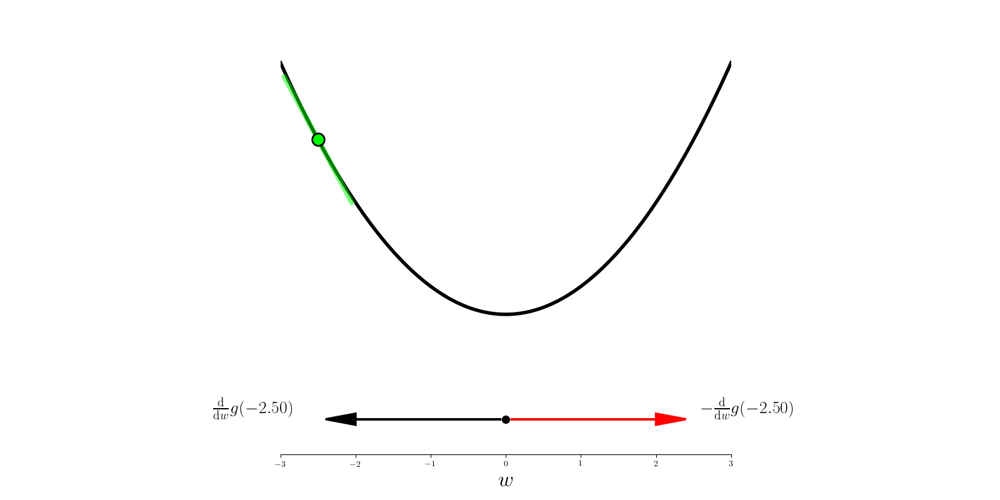
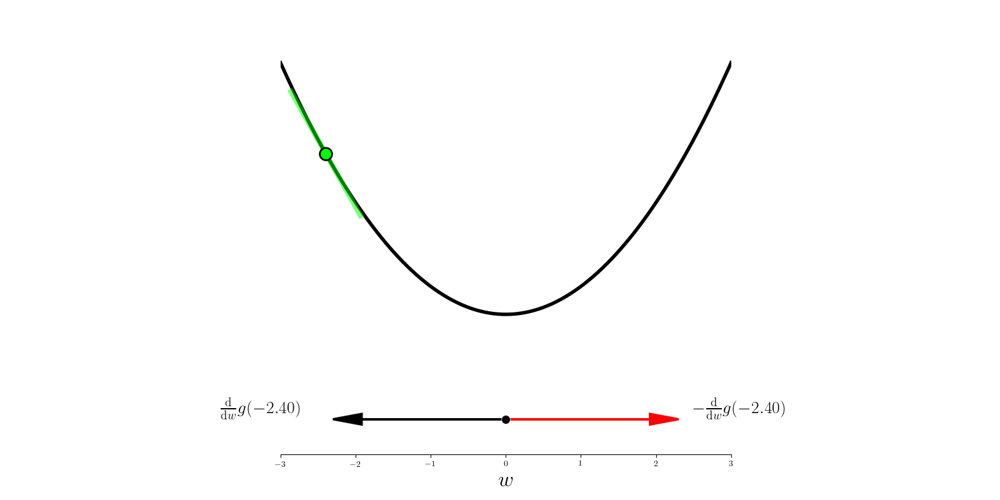
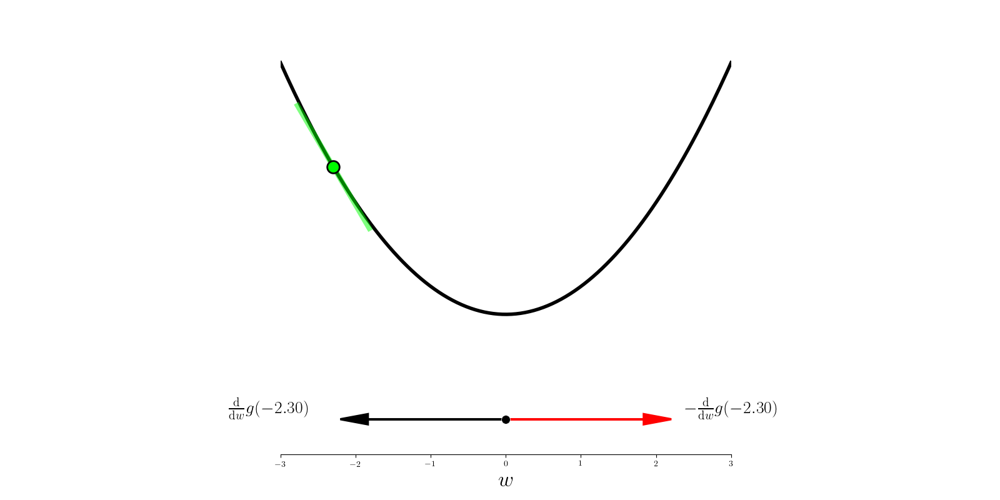
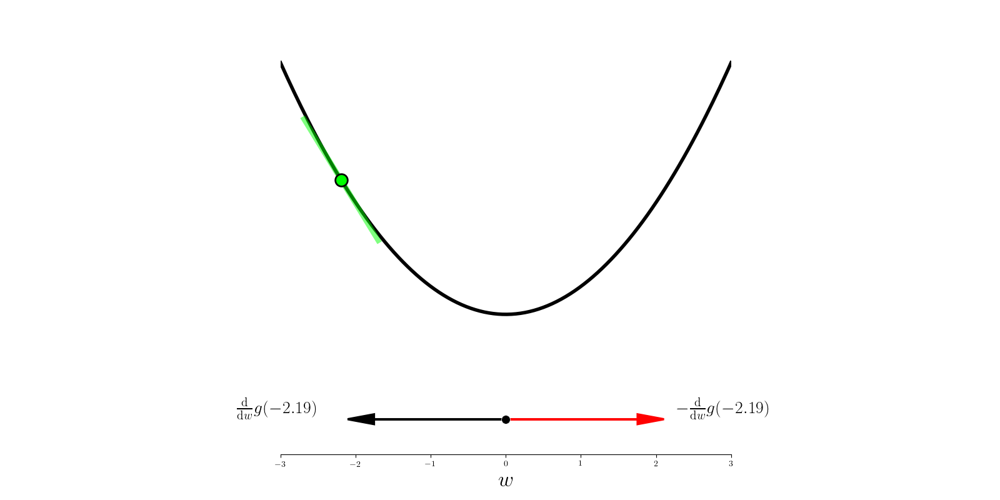
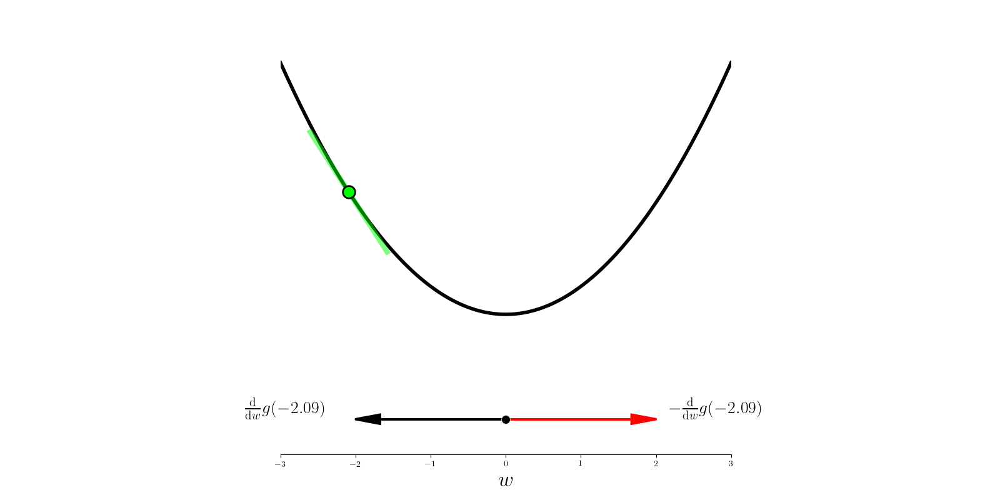
...
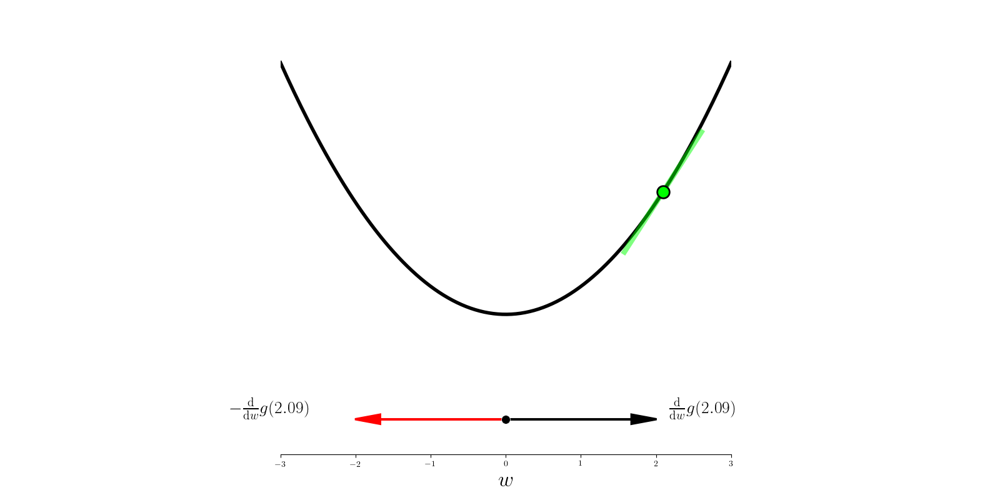
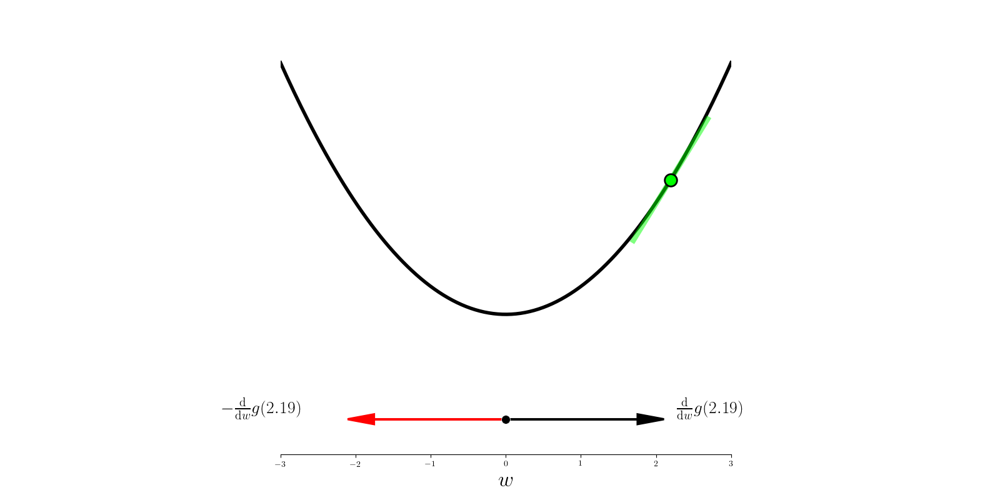
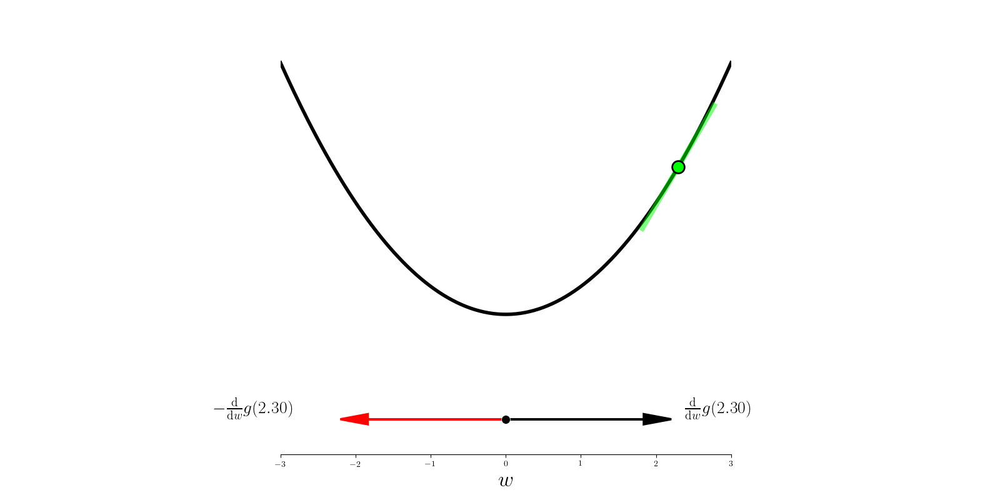
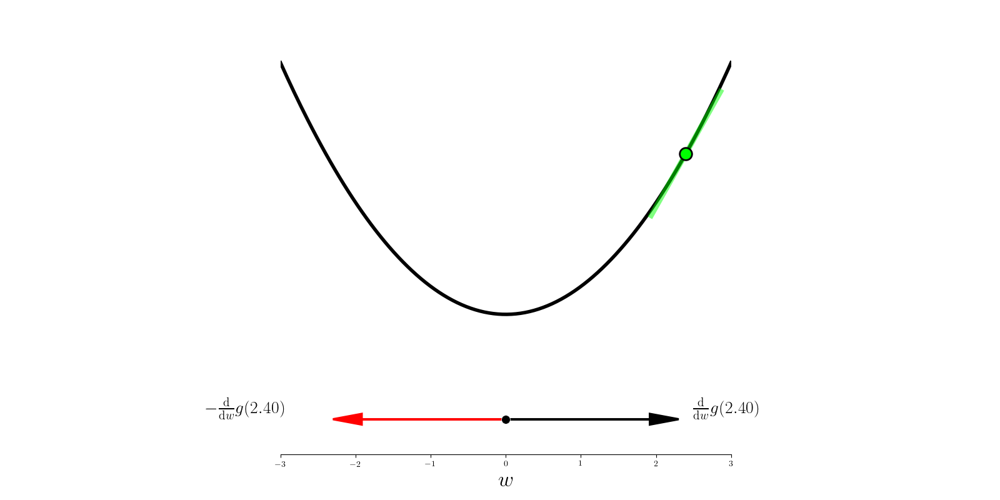
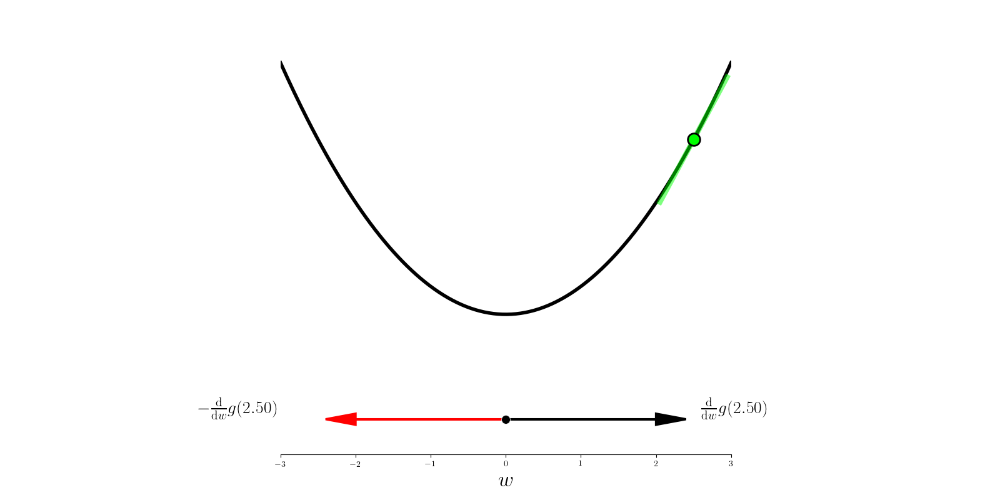

In [6]:
# what function should we play with?  Defined in the next line.
g = lambda w: 1.5 + 0.4*w**2 

# run the visualizer for our chosen input function
callib.derivative_ascent_visualizer.animate_visualize2d(g=g,num_frames = 50,plot_descent = True)

Moving the slider back and forth across the input region, we can see the ascent direction provided by the tangent line always provides a direction of travel that not only increases the value of the line, but of the underlying quadratic as well.

In the next Python cell we produce the same animation as above for the function $g(w) = 1.5 + \text{sin}(w)$.  The changing in the ascent / descent direction is more interesting in this case due to the curvy nature of the sinusoid.


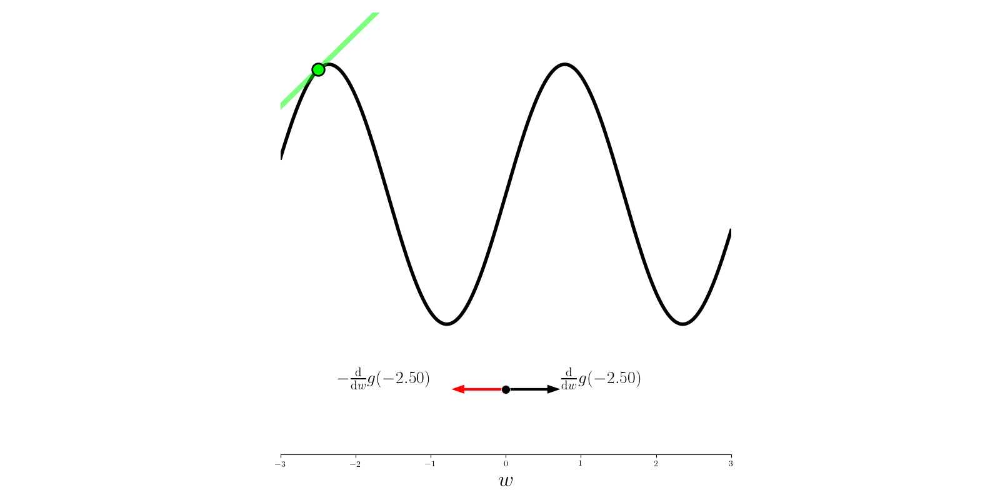
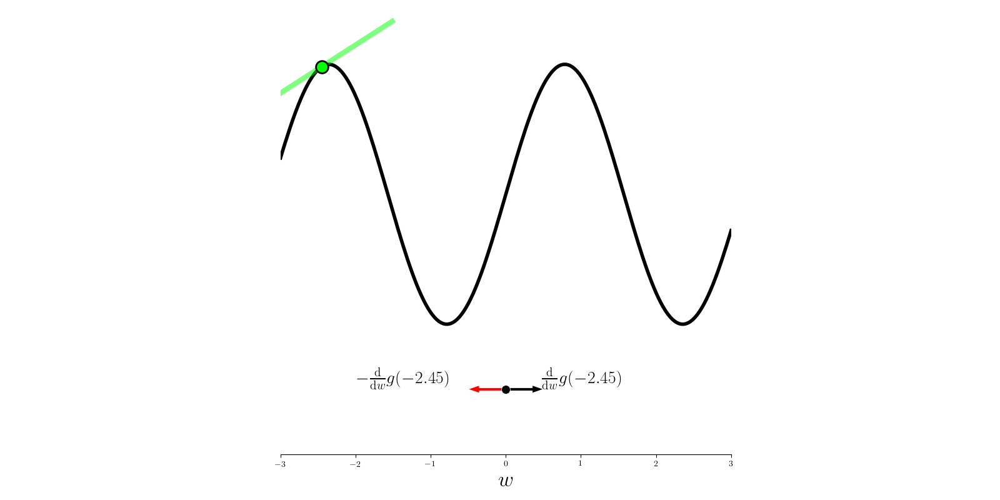
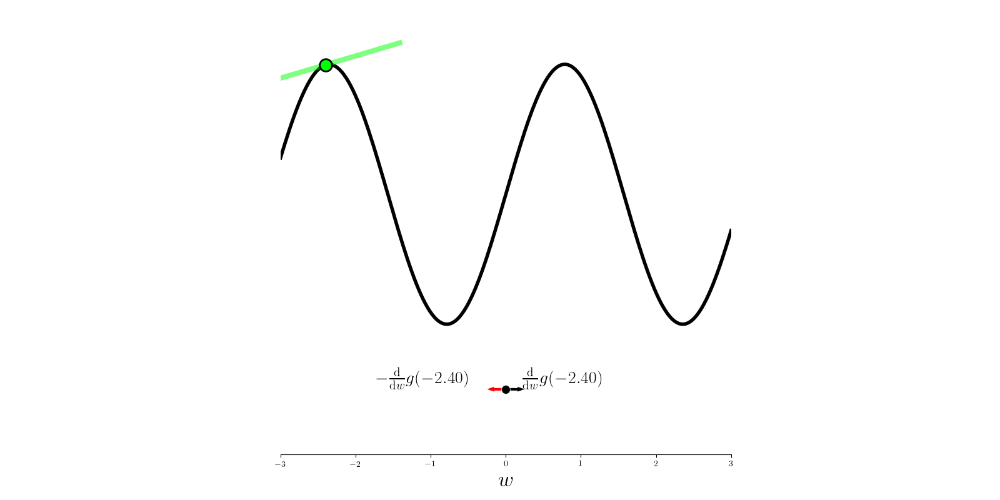
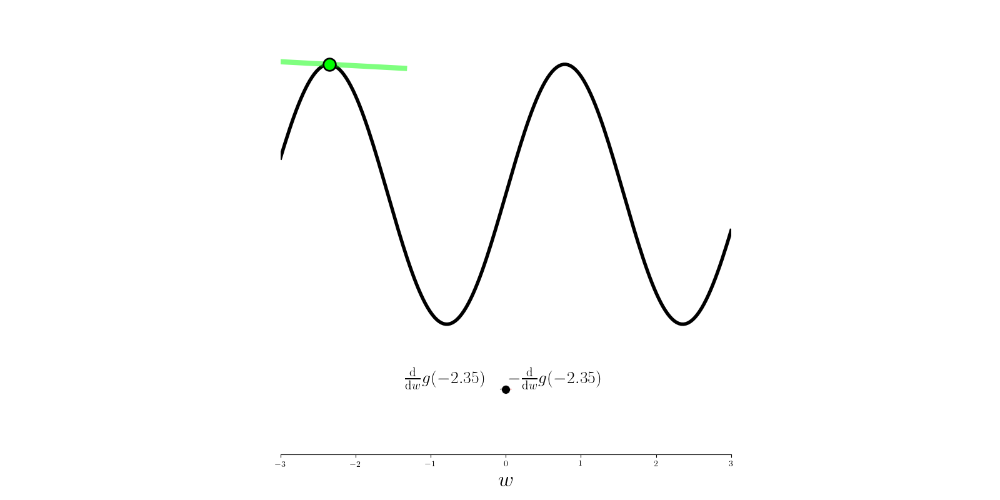
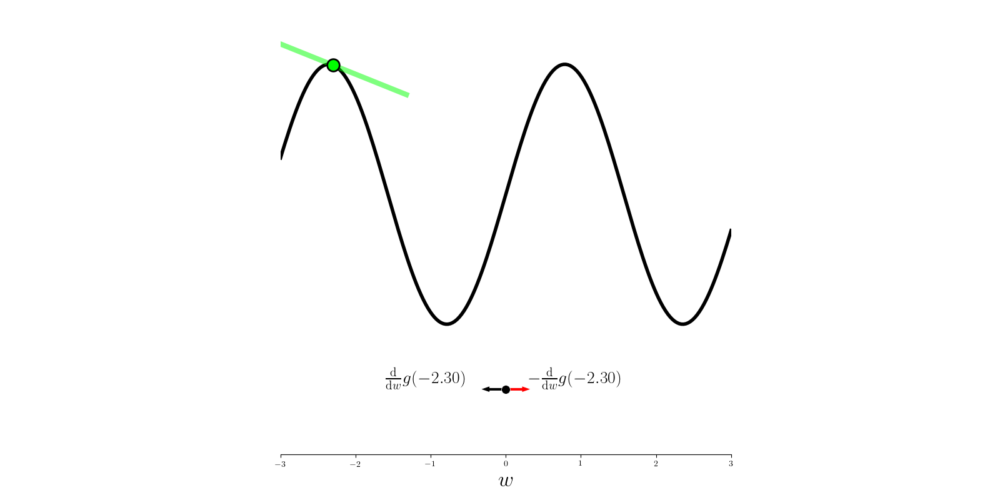
...
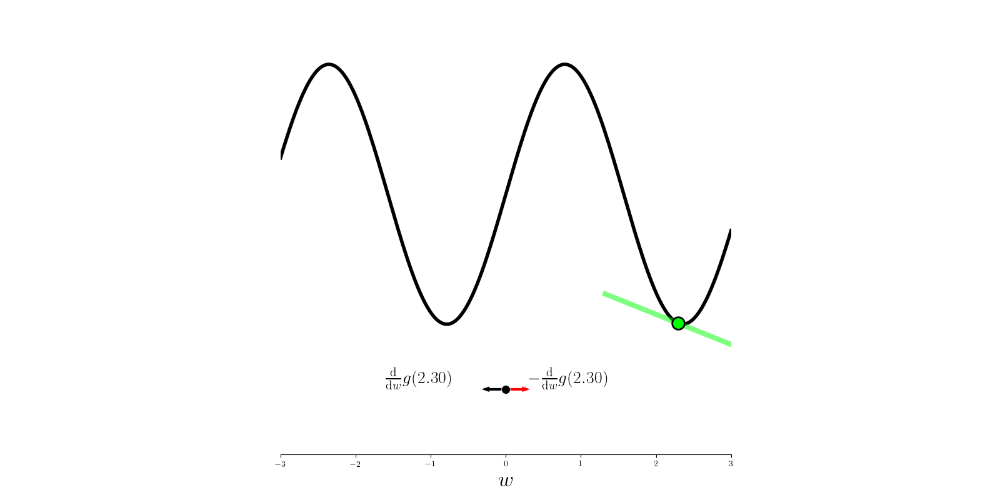
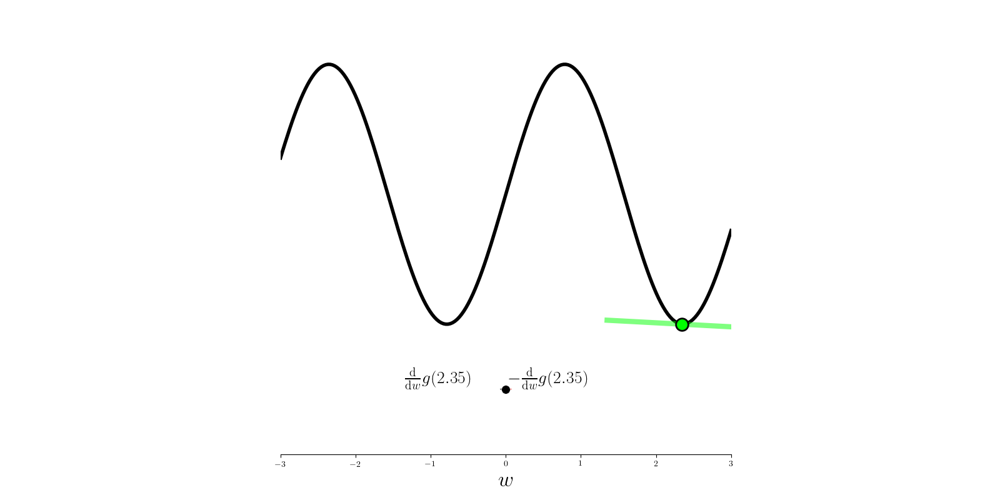
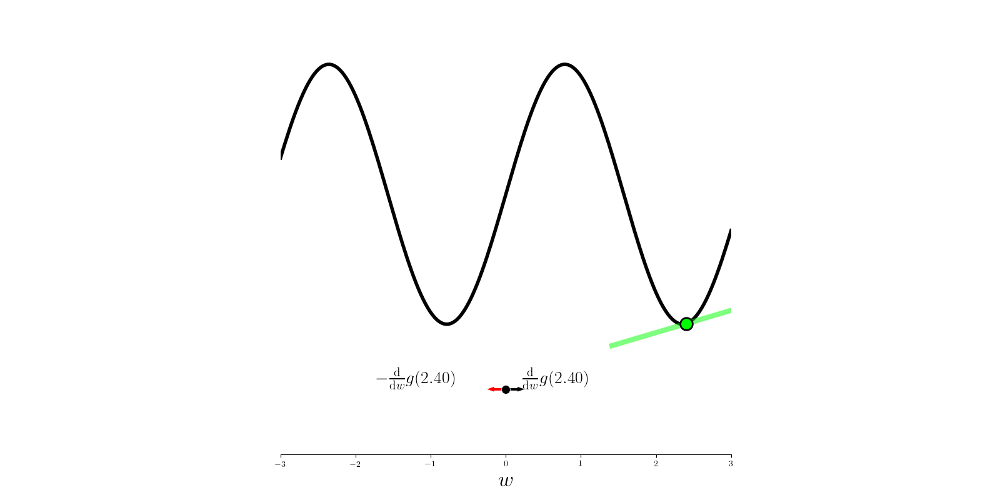
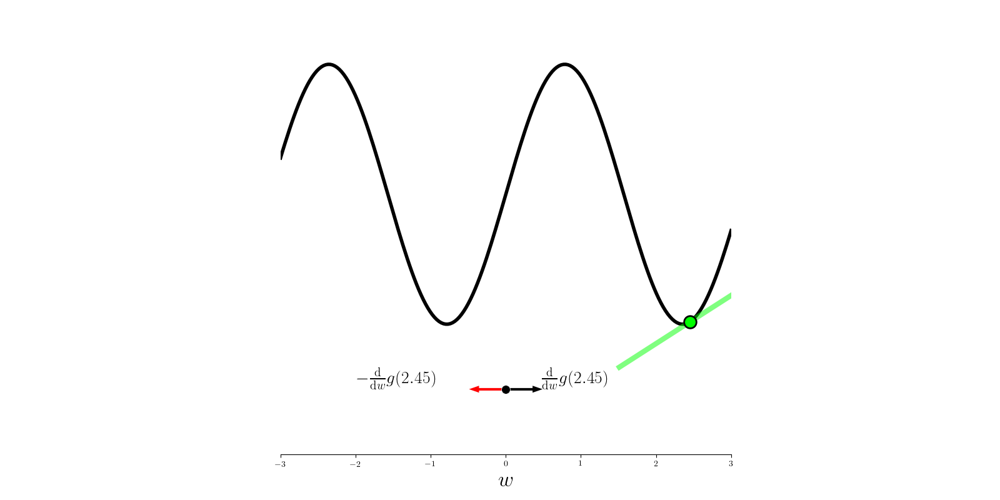
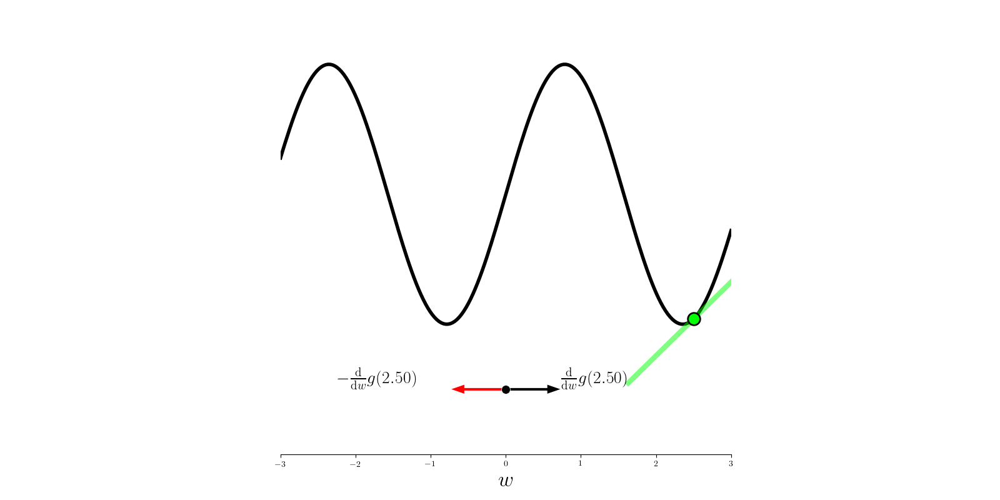

In [7]:
# what function should we play with?  Defined in the next line.
g = lambda w: np.sin(2*w) + 1.5

# run the visualizer for our chosen input function
callib.derivative_ascent_visualizer.animate_visualize2d(g=g,num_frames = 100,plot_descent = True)

At each point we can see that ascent direction provides the right way to go to increase the function value locally (near the point of tangency), and likewise the descent direction provides the direction to travel in to decrease the function value (at least locally near the point of tangency).  

---

Note it is the *direction and not the magnitude of the derivative* that provides ascent / descent direction for the underlying function.  Because of this we can normalize the derivative to have unit length by dividing off its norm as $\frac{\frac{\mathrm{d}}{\mathrm{d}w}g(w)}{\left\Vert \frac{\mathrm{d}}{\mathrm{d}w}g(w) \right\Vert_2 }$.  The value of this unit-length derivative is either +1 or -1, which makes sense since there are only two directions to move in when our input is one dimensional - left or right - and only one way to move in either direction one *unit* (i.e., $\pm 1$).  So it is in fact the case that $\frac{\frac{\mathrm{d}}{\mathrm{d}w}g(w)}{\left\Vert \frac{\mathrm{d}}{\mathrm{d}w}g(w) \right\Vert_2 } = \text{sign}(\frac{\mathrm{d}}{\mathrm{d}w}g(w))$ where $\text{sign}(\cdot)$ takes the function taking the arithmetic sign of an input.  


In short then, for a single input function $g(w)$ we can say at a point $w$ that in terms of unit-length directions we have that $\text{direction of ascent} = \frac{\frac{\mathrm{d}}{\mathrm{d}w}g(w)}{\left\Vert \frac{\mathrm{d}}{\mathrm{d}w}g(w) \right\Vert_2 }$ and $\text{direction of descent} =  -\frac{\frac{\mathrm{d}}{\mathrm{d}w}g(w)}{\left\Vert \frac{\mathrm{d}}{\mathrm{d}w}g(w) \right\Vert_2 }$.

### The steepest ascent direction and the tangent hyperplane

Precisely the same idea holds for higher dimensions as well, only now we have a multitude of partial derivatives supplying ascent information.  When combined into the gradient these partial derivatives define the combined slope of the tangent hyperplane which - as we described in the previous Section general hyperplanes - constitutes the direction of steepest *ascent* for the gradient-generated tangent hyperplane, and thus for the underlying function as well at least locally.  Likewise the negative gradient $-\nabla g(\mathbf{w})$ provides the direction of steepest *descent* on the tangent hyperplane / the function locally, or the direction in which the former decreases the fastest and the latter decreases locally.

Also note as with the single-input case, since we only care about the direction and not the magnitude we can unit-normalize the gradient by dividing by its length as $\frac{\nabla g(\mathbf{w})}{\Vert \nabla g(\mathbf{w}) \Vert_2 }$, giving the unit-length steepest ascent vector, and $-\frac{\nabla g(\mathbf{w})}{\Vert \nabla g(\mathbf{w}) \Vert_2 }$ the unit-length steepest descent vector.

> At any given input point the (unit-normalized) gradient of a multi-input function provides its direction of steepest *ascent*, in other words the direction in which the gradient tangent hyperplane increases the fastest.  By extension the function itself will - at least locally - increase rapidly in this direction as well.  Likewise the negative (unit-normalized) gradient provides the direction of steepest *descent*, or the direction in which the gradient decreases the fastest, as well as (locally) the function as well.

#### <span style="color:#a50e3e;">Example 6. </span>  The gradient as a direction

In the next Python cell we illustrate this fact for the quadratic function 

\begin{equation} 
g(w_1,w_2) = w_1^2 +  w_2^2
\end{equation}

showing the steepest ascent direction given by its gradient at $(-1,1)$.  We plot the direction given by the two partial derivatives here in blue, with the gradient steepest ascent direction shown in black, the negative gradient steepest descent direction in red, and the tangent hyperplane in green.

<IPython.core.display.Javascript object>


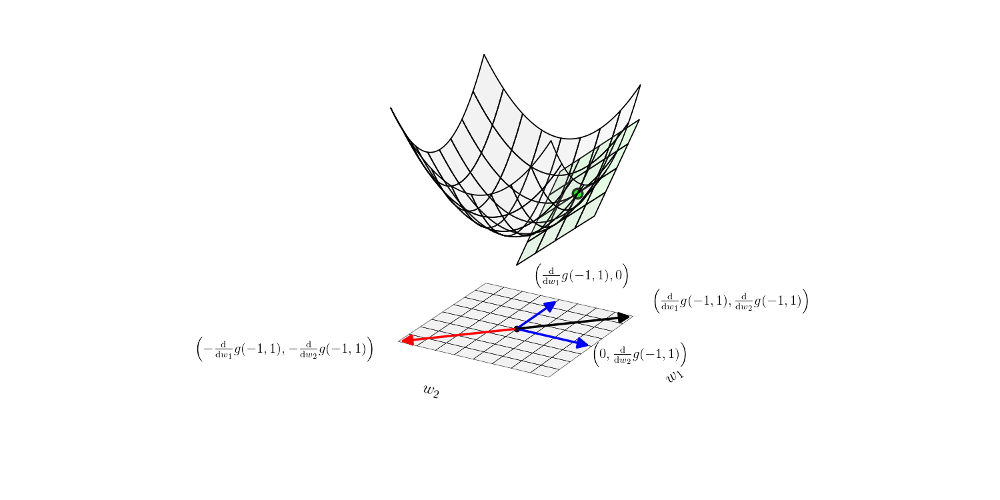

In [2]:
# define function, and points at which to take derivative
func = lambda w:  6 + (w[0])**2 + (w[1])**2
pt1 = [-1,1];

# animate 2d slope visualizer
view = [33,30]
callib.derivative_ascent_visualizer.visualize3d(func=func,view = view,pt1 = pt1,plot_descent = True)

We show the same picture via the Python cell below for the more complicated sinusoid

\begin{equation}
g(w_1,w_2) = 5 + \text{sin}(1.5w_1) - 2w_2
\end{equation}

evaluating the gradient at the origin $(0,0)$.

<IPython.core.display.Javascript object>


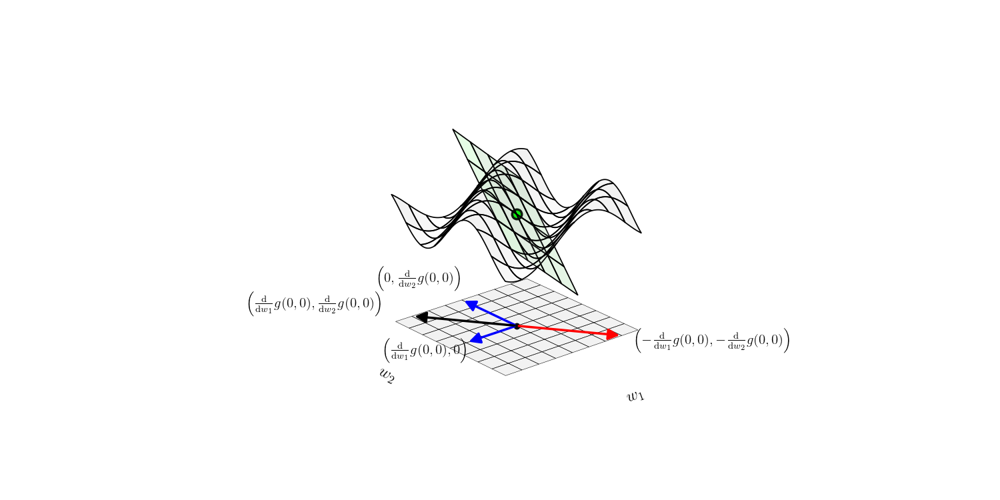

In [3]:
# define function, and points at which to take derivative
func = lambda w:  5 + np.sin(1.5*w[0] - 2*w[1])
pt1 = [0,0];

# animate 2d slope visualizer
view = [33,50]
callib.derivative_ascent_visualizer.visualize3d(func=func,view = view,pt1 = pt1,plot_descent = True)